# GPU programming using PyOpenCL, part 1: Map

This is a set of exercises on the usage of PyOpenCL. There are 6 main classes of parallel algorithms:
1. Map or Element-wise kernels: 1 thread calculates 1 result from 1 input position
2. Gather: 1 thread calculates 1 result from several input data, one typical example is the convolution
3. Scatter: 1 thread uses 1 input element and scatters it on one or several output pixels, this requires the usage of atomic operarions
4. Reduction: Apply the same associative operation on all element of an ensemble, for example the sum of all elements in a list.
5. Scan: also called prefix sum, this algorithm applies the same associative operation to all *previous* elements of a list, for example a cummulative sum (cumsum)
6. Sort: using sorting network like the bitonic sort.

This first tutorial focuses on the Map operation applied to (visible light) image treatement. 
It consists of two part: an example of usage, followed by the direct application in an exercise to be done.

First we load some python modules to be able to read and display images. Then we initialize OpenCL, a context, a command queue, ...

In [1]:
%matplotlib widget
from math import ceil
import numpy as np
from PIL import Image
from matplotlib.pyplot import subplots

In [2]:
import pyopencl as cl
from pyopencl import array as cla

ctx = cl.create_some_context(interactive=False)
queue = cl.CommandQueue(ctx, properties=cl.command_queue_properties.PROFILING_ENABLE)

print(ctx.devices[0])

<pyopencl.Device 'NVIDIA RTX A5000' on 'NVIDIA CUDA' at 0x556cd2d0db30>


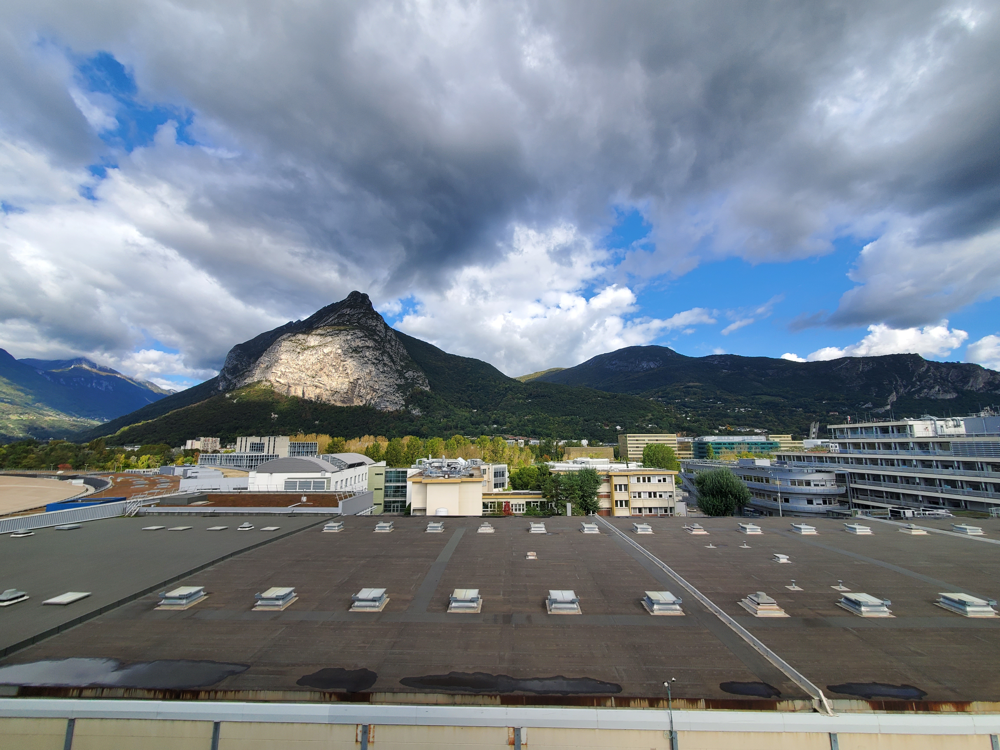

In [3]:
filename = "14h33m35-SM-N970U1.jpg"
Image.open(filename)

In [4]:
img = np.array(Image.open(filename))
img_d = cla.to_device(queue, img)

In [5]:
print(img.shape, img.dtype)

(3456, 4608, 3) uint8


## Demonstration 1: Convert an image in Black & White:

For this, we use this formula:

$$ Y = 0.299 R + 0.587 G + 0.114 B $$

Or the Numpy implementation: 

In [6]:
R, G, B = img.reshape((-1,3)).T
Y = 0.299*R + 0.587*G + 0.114*B
%timeit Y = 0.299*R+0.587*G+0.114*B
Y.shape = img.shape[:2]
Y.shape, Y.dtype

74.3 ms ± 112 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)


((3456, 4608), dtype('float64'))

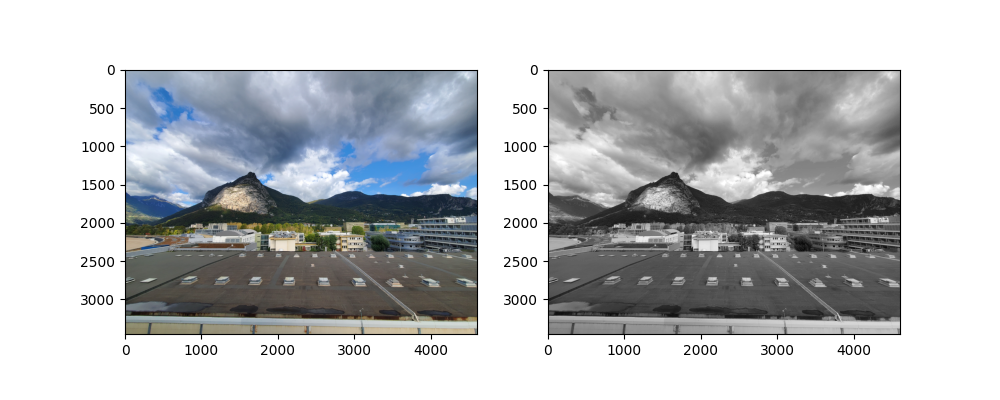

In [7]:
fig, ax = subplots(1, 2, figsize=(10,4))
ax[0].imshow(img)
ax[1].imshow(Y, cmap="gray")

### Using an explicit kernel implementation in PyOpenCl:


In [8]:
Y_d = cla.empty(queue, img.shape[:2], "float32")
wg = None #(32, 32), (256,1), (1, 256), ...
shape = img.shape[:2] if wg is None else tuple(int(ceil(i/w)*w) for i,w in zip(img.shape, wg))
shape, wg

((3456, 4608), None)

In [9]:
%load_ext pyopencl.ipython_ext

In [10]:
%%cl_kernel

kernel void luma(global uchar *rgb, 
                 global float *L, 
                 int height, 
                 int width)
{
    int x, y;
    y = get_global_id(0);
    x = get_global_id(1);
    if ((x<width) && (y<height))
    {
        int i;
        i = x + width*y;
        L[i] = 0.299f * rgb[3*i]
             + 0.587f * rgb[3*i+1]
             + 0.114f * rgb[3*i+2];
    }
}

In [11]:
# %%timeit 
evt = luma(queue, shape, wg,
           img_d.data, Y_d.data, 
           np.int32(img.shape[0]), np.int32(img.shape[1]))
evt.wait()
print(f"Profile time: {(evt.profile.end-evt.profile.start)*1e-6:.3f}ms")

Profile time: 0.945ms


In [12]:
%%timeit 
evt = luma(queue, shape, wg,
           img_d.data, Y_d.data, 
           np.int32(img.shape[0]), np.int32(img.shape[1]))

959 µs ± 2.51 µs per loop (mean ± std. dev. of 7 runs, 1,000 loops each)


In [13]:
%%timeit 
luma(queue, shape, wg,
     img_d.data, Y_d.data, 
     np.int32(img.shape[0]), np.int32(img.shape[1])).wait()

1.02 ms ± 4.35 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)


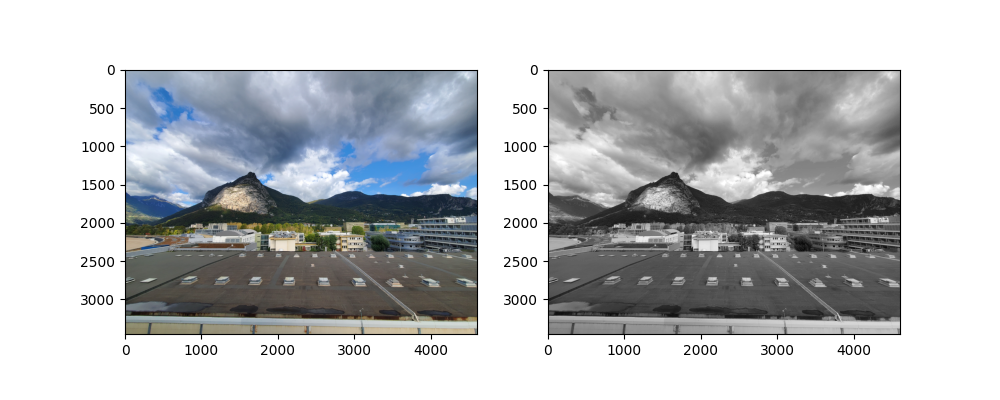

In [14]:
fig, ax = subplots(1, 2, figsize=(10,4))
ax[0].imshow(img)
ax[1].imshow(Y_d.get(), cmap="gray")

In [15]:
assert np.allclose(Y, Y_d.get())

### Using the PyOpenCL algorithm: ElementWise

In [16]:
from pyopencl.elementwise import ElementwiseKernel

In [17]:
# Note one needs to use the output array as first argument so that 
luma_ew = ElementwiseKernel(ctx, 
                            arguments="float *L, uchar *rgb", 
                            operation="L[i] = 0.299f * rgb[3*i] + 0.587f * rgb[3*i+1] + 0.114f * rgb[3*i+2]")

In [18]:
evt = luma_ew(Y_d, img_d)
evt.wait()
print(f"Profile time: {(evt.profile.end-evt.profile.start)*1e-6:.3f}ms")
assert np.allclose(Y, Y_d.get())

Profile time: 0.218ms


In [19]:
%timeit luma_ew(Y_d, img_d).wait()

227 µs ± 57.5 ns per loop (mean ± std. dev. of 7 runs, 1,000 loops each)


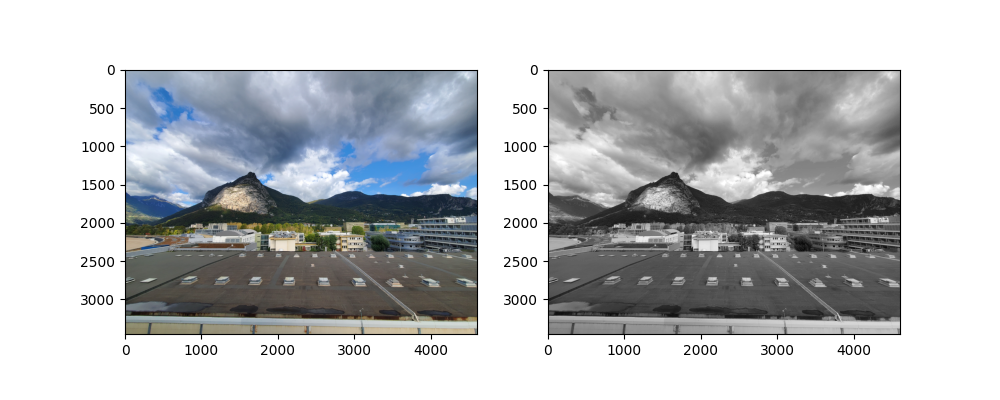

In [20]:
fig, ax = subplots(1, 2, figsize=(10,4))
ax[0].imshow(img)
ax[1].imshow(Y_d.get(), cmap="gray")

### Variation: Same with desaturation
i.e. max(R,G,B)

In [21]:
R, G, B = img.reshape((-1,3)).T
D = np.maximum(R,np.maximum(G,B))
%timeit np.maximum(R,np.maximum(G,B))
D.shape = img.shape[:2]
D_d = cla.empty(queue, D.shape, "uint8")

13.1 ms ± 10.9 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


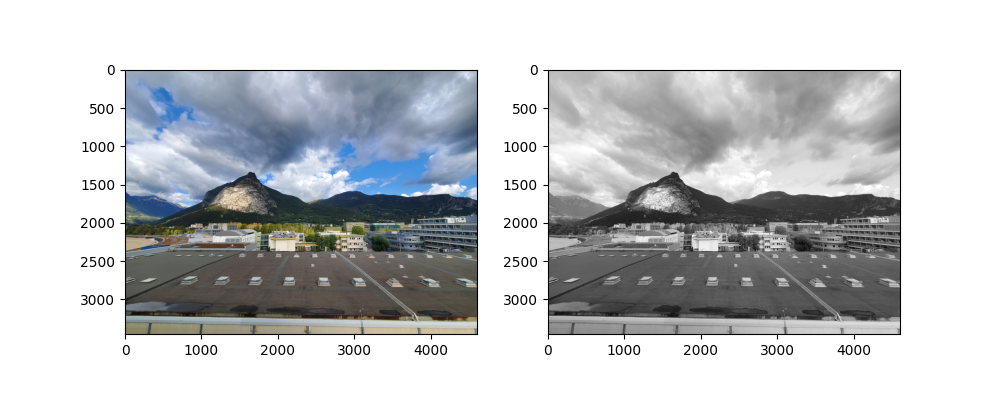

In [22]:
fig, ax = subplots(1, 2, figsize=(10,4))
ax[0].imshow(img)
ax[1].imshow(D, cmap="gray")

In [23]:
desat_ew = ElementwiseKernel(ctx, 
                            arguments="uchar *L, uchar *rgb", 
                            operation="L[i] = max(max(rgb[3*i], rgb[3*i+1]), rgb[3*i+2])")
evt = desat_ew(D_d, img_d)
evt.wait()
print(f"Profile time: {(evt.profile.end-evt.profile.start)*1e-6:.3f}ms")
assert np.allclose(D, D_d.get())

Profile time: 0.132ms


### Now it is your turn:

Image are stored in JPEG files and each pixel consists in 3 values for Red, Green and Blue channels encoded in 8-bits unsigned integer. 
The luminosity for each of those channel is not linear to the value but follow a gamma curve, write the fuction that converts the gamma-compressed value (from 0 to 255)  into a linear floating point after decompression.

https://en.wikipedia.org/wiki/SRGB#Transformation

* Write a kernel that converts the sRGB to linear
* Write an element-wise function that does the same.

Here is the numpy reference implementation:

In [24]:
def np_linear(sRGB):
    return np.where(sRGB<10, sRGB/(255*12.92), (((sRGB/255)+0.055)/1.055)**2.4)
%timeit np_linear(img)

873 ms ± 540 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [25]:
# Write your own kernel here:

In [26]:
# Test your kernel:

In [27]:
#Use the ElementWise class